In [1]:
%matplotlib inline

import os

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from pathlib import Path

DATA_RAW = os.path.join(os.getcwd(), os.pardir, 'data', 'raw')

In [2]:
import sys
sys.path.append(os.path.join(os.getcwd(), os.pardir, 'src'))

%load_ext autoreload

%autoreload 2
from visualization.visualize import *

# `data/raw/Data_request_20171201.xlsx`
### WHO Raw Subnational Data

This is the raw subnational data provided by the WHO.

In [3]:
dtypes = {
    "Iso Code": 'category',
    "Country Name": 'category',
    'WHO Region': 'category',
    'Year': 'int',
    'Vaccine Type': 'category',
    'Admin1': 'category',
    'Admin2': 'category',
    'DenomType': 'category',
    'Denominator': 'float',
    'Numerator': 'float',
    'Coverage': 'float'
}

In [4]:
df = pd.read_excel(os.path.join(DATA_RAW, 'Data_request_20171201.xlsx'), dtype=dtypes, na_values=[-2222, -4444])

print(f"Data has {df.shape[0]} rows and {df.shape[1]} columns")

df.head(2)

Data has 178333 rows and 11 columns


,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage
0,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aab Band,1.0,1266.0,NaN,51.801245
1,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aab Kamari,1.0,4599.0,NaN,94.674670


In [5]:
pd.set_option('display.max_rows', 200)
cntrs = pd.Series(df['Country Name'].str.strip().unique())
cntrs.sort_values()

0                         Afghanistan
9                             Albania
34                            Algeria
8                              Angola
119                         Argentina
10                            Armenia
11                         Azerbaijan
16                            Bahamas
126                           Bahrain
15                         Bangladesh
105                          Barbados
106                           Belarus
109                           Belgium
18                             Belize
13                              Benin
20                             Bhutan
7                             Bolivia
17               Bosnia & Herzegovina
21                           Botswana
19                             Brazil
5                              Brunei
114                          Bulgaria
14                       Burkina Faso
12                            Burundi
22                                CAR
29                         Cabo Verde
24          

In [6]:
df.describe(include='all')

,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage
count,178333,178333,178333,178333.0,178333,171572,169973,155561.0,172440.000000,49797.000000,140993.000000
unique,136,136,6,NaN,32,2217,20685,4.0,NaN,NaN,NaN
top,ETH,Ethiopia,AFRO,NaN,DTP3,Oromiya,Samba,2.0,NaN,NaN,NaN
freq,18348,18348,88374,NaN,22895,6644,56,107507.0,NaN,NaN,NaN
mean,NaN,NaN,NaN,2016.0,NaN,NaN,NaN,NaN,7240.041696,3128.050184,94.519876
std,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,15521.187017,15482.647383,177.562789
min,NaN,NaN,NaN,2016.0,NaN,NaN,NaN,NaN,0.000000,0.000000,0.000000
25%,NaN,NaN,NaN,2016.0,NaN,NaN,NaN,NaN,685.000000,74.000000,75.045427
50%,NaN,NaN,NaN,2016.0,NaN,NaN,NaN,NaN,3237.000000,221.000000,92.471835
75%,NaN,NaN,NaN,2016.0,NaN,NaN,NaN,NaN,7421.000000,717.000000,102.540107


# Countries

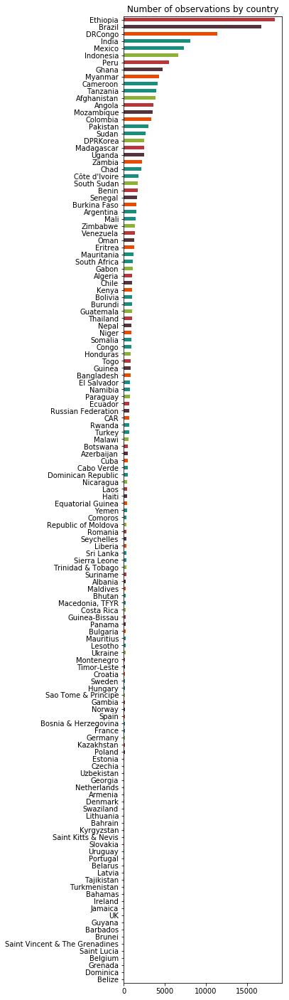

In [7]:
df['Country Name'].value_counts(ascending=True).plot.barh(figsize=(4, 25))
plt.title("Number of observations by country");

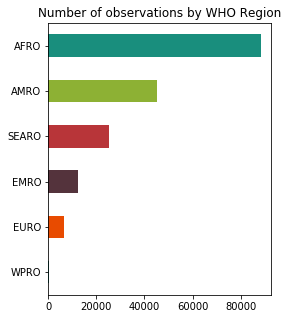

In [8]:
df['WHO Region'].value_counts(ascending=True).plot.barh(figsize=(4, 5))
plt.title("Number of observations by WHO Region");

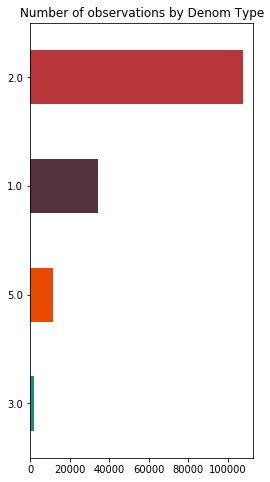

In [9]:
# Denom Type
df['DenomType'].value_counts(ascending=True).plot.barh(figsize=(4, 8))
plt.title("Number of observations by Denom Type");

In [10]:
df['recalc_numerator'] = np.where(pd.notnull(df.Numerator),
                                  df.Numerator,
                                  (df.Coverage / 100.) * df.Denominator)

# Geography

In [11]:
(df.groupby(['WHO Region'])['Country Name'].nunique())

WHO Region
AFRO     46
AMRO     32
EMRO      7
EURO     38
SEARO    11
WPRO      2
Name: Country Name, dtype: int64

In [12]:
both_concat = np.where(pd.notnull(df.Admin2) & pd.notnull(df.Admin1),
                       df.Admin1.astype(str) + " - " + df.Admin2.astype(str),
                       df.Admin2)

df['available_admin'] = np.where(pd.notnull(df.Admin2),
                                 both_concat,
                                 df.Admin1)

df = df[pd.notnull(df.available_admin)]

In [13]:
df.groupby(['Country Name'])['available_admin'].nunique().sort_values()

Country Name
Belgium                              3
Swaziland                            4
Bahrain                              4
UK                                   4
Brunei                               5
Tajikistan                           6
Latvia                               6
Turkmenistan                         6
Belize                               6
Grenada                              7
Portugal                             7
Gambia                               7
Sao Tome & Principe                  7
Dominica                             7
Belarus                              7
Saint Lucia                          8
Slovakia                             8
Ireland                              8
Saint Vincent & The Grenadines       9
Kyrgyzstan                           9
Barbados                            10
Lithuania                           10
Mauritius                           10
Lesotho                             10
Guyana                              10
Denmark     

In [14]:
more_than_1_level = lambda x: x.nunique() > 1

rollup = (df.groupby(['Country Name'])[['Admin1', 'Admin2']]
            .agg({'Admin1': more_than_1_level, 'Admin2': more_than_1_level, 'WHO Region': 'first'}))

rollup = rollup.assign(both=lambda x: x.Admin1 & x.Admin2)

print(f"{(~rollup.Admin2 & rollup.Admin1).sum()} countries with just Admin1")
print(f"{(rollup.Admin2 & ~rollup.Admin1).sum()} countries with just Admin2")
print(f"{rollup.both.sum()} countries with both")

/Users/bull/anaconda3/envs/subnational-vaccines/lib/python3.6/site-packages/pandas/core/groupby.py:4291: FutureWarning: using a dict with renaming is deprecated and will be removed in a future version
  return super(DataFrameGroupBy, self).aggregate(arg, *args, **kwargs)


39 countries with just Admin1
16 countries with just Admin2
81 countries with both


In [15]:
populations = pd.read_html(os.path.join(DATA_RAW,
                                        os.pardir,
                                        'external',
                                        'wikipedia_country_population_table.html'))[0]

populations.head()

,Rank,Country or area,UN continental region[1],UN statistical region[1],Population (1 July 2016)[2],Population (1 July 2017)[2],Change
0,â,World,â,â,7466964280,7550262101,7000111555135228260â +1.1%
1,1,China[a],Asia,Eastern Asia,1403500365,1409517397,6999428716097982630â +0.4%
2,2,India,Asia,Southern Asia,1324171354,1339180127,7000113344643460699â +1.1%
3,3,United States,Americas,Northern America,322179605,324459463,6999707635730076710â +0.7%
4,4,Indonesia,Asia,South-Eastern Asia,261115456,263991379,7000110139899186970â +1.1%


In [16]:
remaps = {
    'bosnia and herzegovina': 'bosnia & herzegovina',
    'cape verde': 'cabo verde',
    'central african republic': 'car',
    'czech republic': 'czechia',
    "ivory coast": "côte d'ivoire",
    "north korea": "dprkorea",
    "democratic republic of the congo": "drcongo",
    "the gambia": "gambia",
    "republic of macedonia": "macedonia, tfyr",
    "moldova": "republic of moldova",
    "russia": "russian federation",
    "saint kitts and nevis": "saint kitts & nevis",
    "saint vincent and the grenadines": "saint vincent & the grenadines",
    "sao tome and principe": "sao tome & principe",
    "east timor": "timor-leste",
    "trinidad and tobago": "trinidad & tobago",
    "united kingdom": "uk",
}


remove_footnotes = lambda s: s[:s.find('[')] if '[' in s else s

df['normalized_country'] = df['Country Name'].str.lower()
populations['normalized_country'] = populations['Country or area'].str.lower().apply(remove_footnotes).replace(remaps)

np.setdiff1d(populations.normalized_country.unique(),
             df.normalized_country.unique())


(populations[populations.normalized_country.isin(np.setdiff1d(populations.normalized_country.unique(),
             df.normalized_country.unique()))].sort_values(
                ['UN continental region[1]', 'Population (1 July 2017)[2]'], ascending=False))['UN continental region[1]'].value_counts()

Oceania     23
Asia        23
Americas    21
Europe      20
Africa      10
â          1
Name: UN continental region[1], dtype: int64

In [17]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

to_plot = df.groupby('Iso Code')['Country Name'].agg(lambda x: 100)

data = [ dict(
        type = 'choropleth',
        locations = to_plot.index,
        z = to_plot,
        marker = dict(
            line = dict (
                color = 'rgb(180,180,180)',
                width = 0.0
            ) ),
      ) ]

layout = dict(
    title = 'Map',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection = dict(
            type = 'Mercator'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot( fig, validate=False, filename='d3-world-map' )

In [18]:
GAVI = pd.read_csv(os.path.join(DATA_RAW, os.pardir, 'external', 'GAVI_2016.csv'))
GAVI.sort_values('committed', ascending=False)


,country,committed
22,Nigeria,186615500.0
21,Pakistan,120927500.0
52,Democratic Republic of the Congo (Kinshasa),100590293.0
49,Ethiopia,92570000.0
67,Bangladesh,74755926.0
40,India,59410000.0
5,United Republic of Tanzania,50930742.0
6,Uganda,46436500.0
10,Sudan,45307207.0
71,Afghanistan,40103734.0


In [19]:
df.normalized_country.sort_values().unique()

array(['afghanistan', 'albania', 'algeria', 'angola', 'argentina',
       'armenia', 'azerbaijan', 'bahamas', 'bahrain', 'bangladesh',
       'barbados', 'belarus', 'belgium', 'belize', 'benin', 'bhutan',
       'bolivia', 'bosnia & herzegovina', 'botswana', 'brazil', 'brunei',
       'bulgaria', 'burkina faso', 'burundi', 'cabo verde', 'cameroon',
       'car', 'chad', 'chile', 'colombia', 'comoros', 'congo',
       'costa rica', 'croatia', 'cuba', 'czechia', "côte d'ivoire",
       'denmark', 'dominica', 'dominican republic', 'dprkorea', 'drcongo',
       'ecuador', 'el salvador', 'equatorial guinea', 'eritrea',
       'estonia', 'ethiopia', 'france', 'gabon', 'gambia', 'georgia',
       'germany', 'ghana', 'grenada', 'guatemala', 'guinea',
       'guinea-bissau', 'guyana', 'haiti', 'honduras', 'hungary', 'india',
       'indonesia', 'ireland', 'jamaica', 'kazakhstan', 'kenya',
       'kyrgyzstan', 'laos', 'latvia', 'lesotho', 'liberia', 'lithuania',
       'macedonia, tfyr', 'madaga

In [20]:
GAVI.country.nunique()

72

In [21]:
gavi_rempas = {
    'central african republic': 'car',
    'congo, republic of (brazzaville)': 'congo',
    "cote d'ivoire": "côte d'ivoire",
    "democratic people's republic of korea": "dprkorea",
    "democratic republic of the congo (kinshasa)": "drcongo",
    "kyrgyzstan republic": "kyrgyzstan",
    "lao people's democratic republic": "laos",
    "sao tome and principe": "sao tome & principe",
    "timor-leste (east timor)": "timor-leste",
    "united republic of tanzania": "tanzania",
}


ms = np.setdiff1d(GAVI.country.str.lower().replace(gavi_rempas).sort_values(),
                  df.normalized_country.sort_values().unique())

In [22]:
", ".join(map(str.capitalize, ms))

'Cambodia, Djibouti, Kiribati, Mongolia, Nigeria, Papua new guinea, Solomon islands, Viet nam'

## Vaccines

In [23]:
vax_metadata_path = Path('../data/interim/vax_metadata.csv')

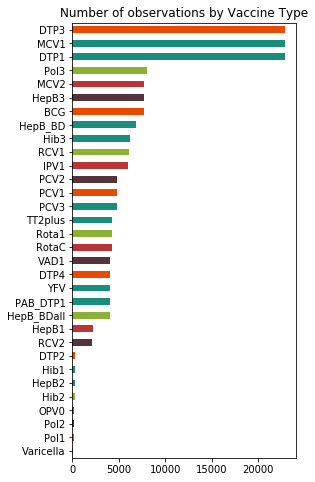

In [24]:
# vaccine metadata on the Sheet "Tidy"
#  https://docs.google.com/spreadsheets/d/1X769pklcNg3NI5is-IRh6cCVXV3p03o9MhSaQpM2c7E/edit#gid=303669444

if not vax_metadata_path.exists():
    vax_meta = pd.read_clipboard(header=None)
    vax_meta.columns = ['group', 'vaccine', 'timing']
    
    vax_meta.to_csv(vax_metadata_path)
else:
    vax_meta = pd.read_csv(vax_metadata_path, index_col=0)
    
df['Vaccine Type'].value_counts(ascending=True).plot.barh(figsize=(4, 8))
plt.title("Number of observations by Vaccine Type");

In [25]:
df['indicator'] = 1

In [26]:
df = df.merge(vax_meta, how='left', left_on='Vaccine Type', right_on='vaccine')

ValueError: Buffer dtype mismatch, expected 'Python object' but got 'double'

Exception ignored in: 'pandas._libs.lib.is_bool_array'
ValueError: Buffer dtype mismatch, expected 'Python object' but got 'double'


In [27]:
df[pd.isnull(df.group)]['Vaccine Type'].unique()

array(['TT2plus', 'HepB_BDall'], dtype=object)

In [28]:
df.groupby('group').recalc_numerator.sum()

group
BCG              7.389664e+07
DTP              1.688416e+08
H. influenzae    5.943764e+07
HepB             9.618273e+07
Measles          1.234839e+08
Neo-natal DTP    6.084521e+06
Pneumococcal     9.742575e+07
Polio            1.140525e+08
Rotavirus        3.905901e+07
Rubella          1.281740e+07
Varicella        1.057920e+05
Vitamin A        9.563094e+06
Yellow fever     1.002689e+07
Name: recalc_numerator, dtype: float64

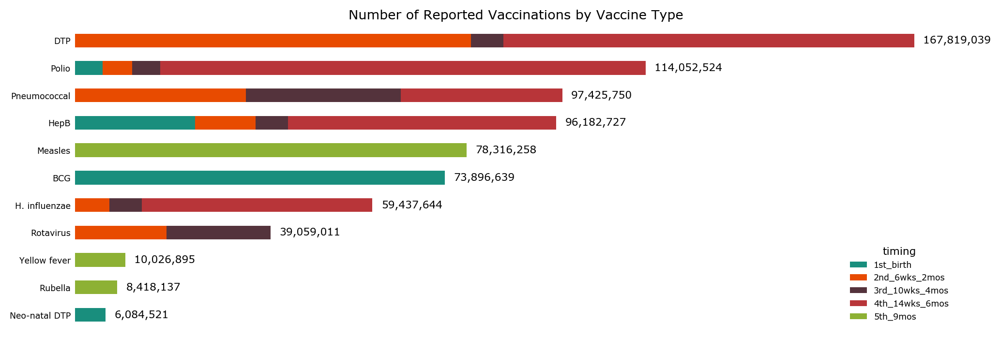

In [29]:
FS = 8

with styled_fig_ax(size='wide', font_size=FS, x_formatter=comma_func_formatter(), zero_lines=False) as ax:
    to_plot = df.pivot_table(dropna=False,
                             columns=['timing'],
                             index=['group'],
                             values='recalc_numerator',
                             fill_value=0,
                             aggfunc='sum')
    
    # sorted
    to_plot = to_plot.loc[to_plot.sum(axis=1).sort_values().index, :]
    
    labeled_bar(ax,
                to_plot,
                font_size=FS,
                horizontal=True,
                label_formatter=comma_func_formatter(),
                stacked=True)
    
    ax.set_ylabel('')
    ax.set_title('Number of Reported Vaccinations by Vaccine Type')

In [30]:
# confirm that for every country, the same vaccines are reported at every admin-2 level region
(df.groupby(['Country Name', 'Vaccine Type']).available_admin.nunique().unstack(-1).nunique(axis=1) == 1).all()

True

In [31]:
df['Vaccine Type'].nunique()

32

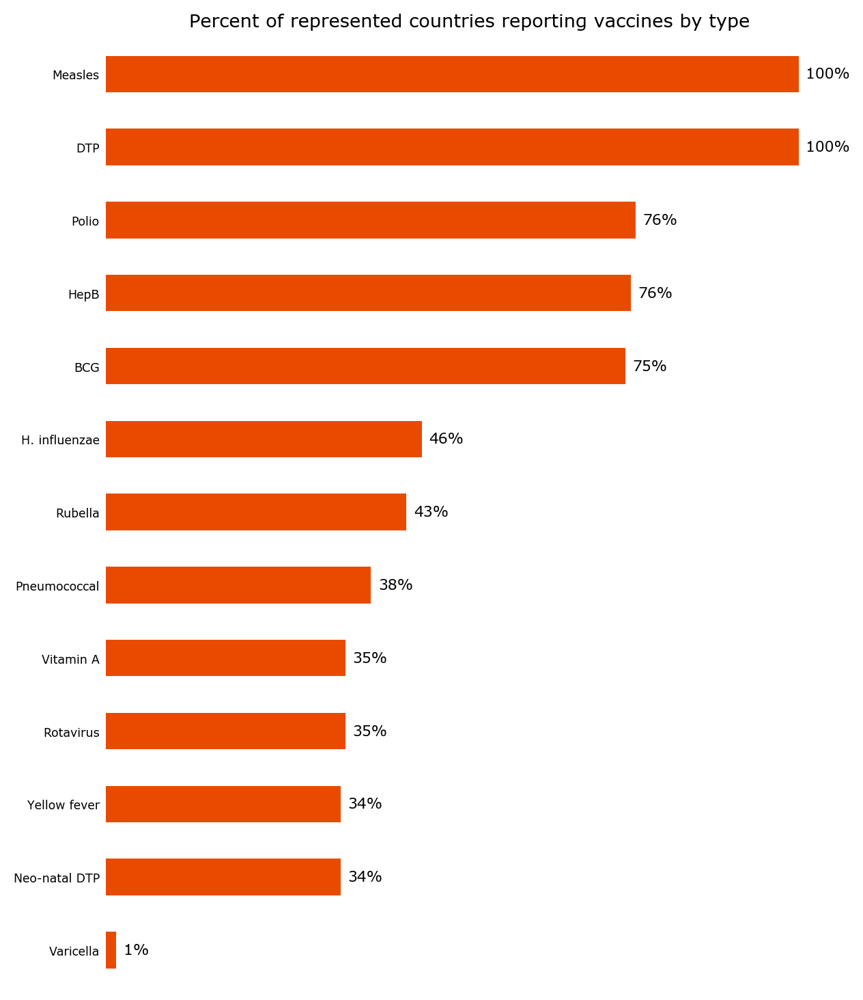

In [32]:
coutries_reporting = (df.groupby(['group'])['Country Name'].nunique() / df['Country Name'].nunique()).sort_values()

with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                coutries_reporting,
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['orange'])
    
    
    ax.set_ylabel('')
    ax.set_title('Percent of represented countries reporting vaccines by type')


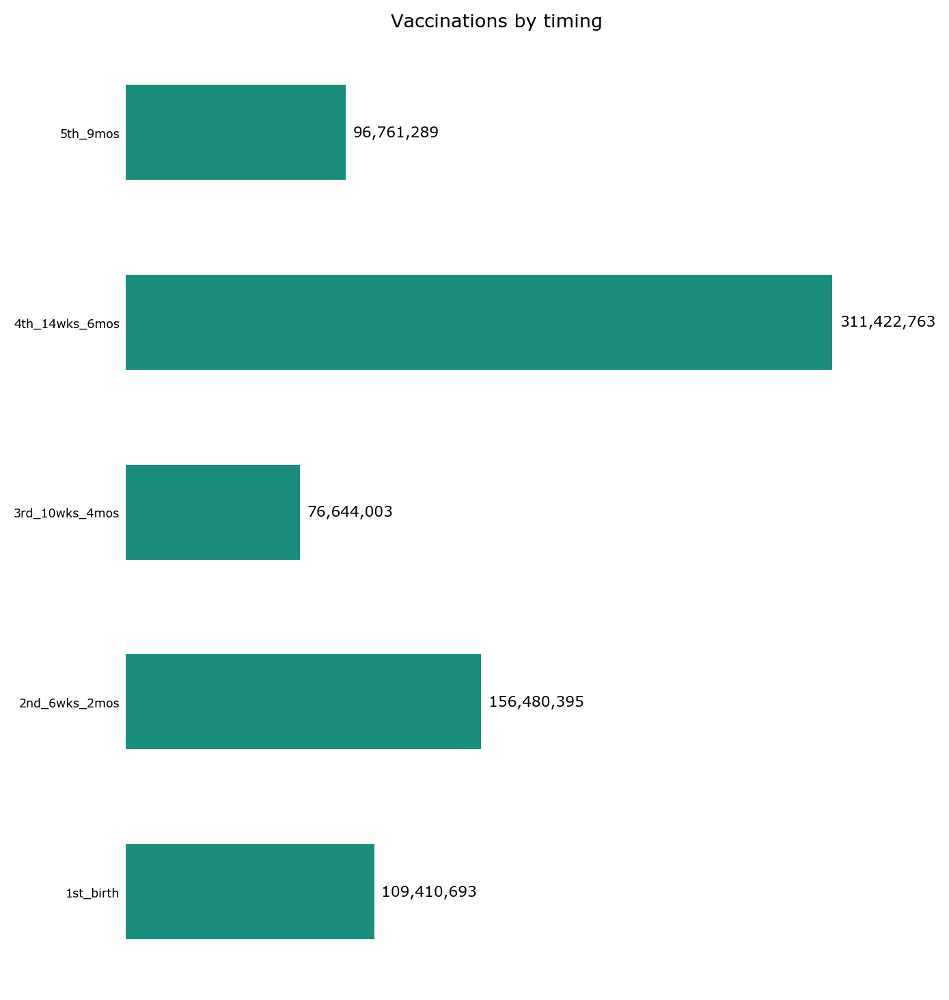

In [33]:
coutries_reporting = (df.groupby(['timing']).recalc_numerator.sum().sort_index())

with styled_fig_ax(size='tall', font_size=FS, x_formatter=comma_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                coutries_reporting,
                font_size=FS,
                horizontal=True,
                label_formatter=comma_func_formatter(),
                color=PALETTE['green'])
    
    ax.set_ylabel('')
    ax.set_title('Vaccinations by timing')


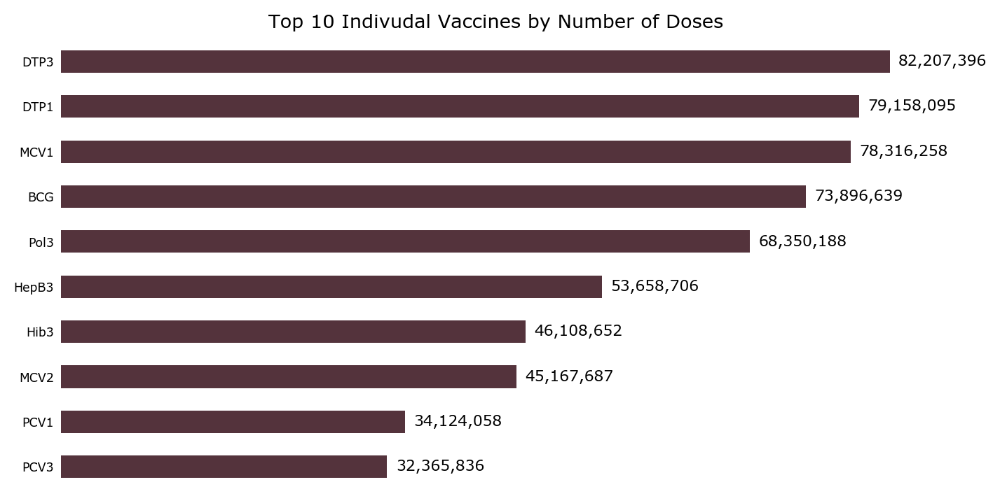

In [34]:
top_10_vaccines = (df.groupby(['Vaccine Type']).recalc_numerator.sum().sort_values().tail(10))

with styled_fig_ax(size='quarter', font_size=FS, x_formatter=comma_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                top_10_vaccines,
                font_size=FS,
                horizontal=True,
                label_formatter=comma_func_formatter(),
                color=PALETTE['purple'])
    
    
    ax.set_ylabel('')
    ax.set_title('Top 10 Indivudal Vaccines by Number of Doses')


In [35]:
pd.isnull(df.Numerator[df['WHO Region'] == 'AFRO']).all()

True

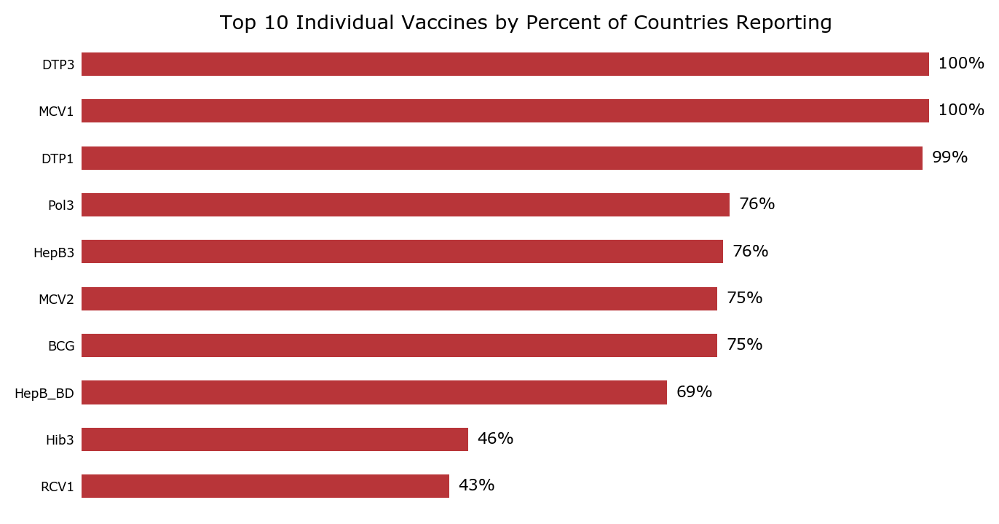

In [36]:
top_10_by_pct_cout = ((df.groupby(['Vaccine Type'])['Country Name'].nunique() / df['Country Name'].nunique())
                         .sort_values()
                         .tail(10))

with styled_fig_ax(size='quarter', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                top_10_by_pct_cout,
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['red'])
    
    
    ax.set_ylabel('')
    ax.set_title('Top 10 Individual Vaccines by Percent of Countries Reporting')


In [37]:
def _all_reported(sub_df):
    admin_vax = sub_df.groupby(['available_admin', 'Vaccine Type']).indicator.any().unstack().fillna(0)
    return admin_vax.sum() / admin_vax.shape[0]


bad = (df.groupby(['Country Name']).apply(_all_reported))
(bad == 1).all()


True

In [75]:
df['reported'] = pd.notnull(df.recalc_numerator)

In [84]:
def pcttt(x):
#     print(x)
    return (x == 1.0).sum() / pd.notnull(x).sum()


(df.groupby(['group', 'WHO Region', 'Country Name'])
   .apply(lambda x: x.reported.any().astype(float))
   .unstack()
   .apply(pcttt, axis=1)
   .unstack())


WHO Region,AFRO,AMRO,EMRO,EURO,SEARO,WPRO
group,,,,,,
BCG,0.978261,NaN,1.0,0.605263,0.909091,1.0
DTP,0.978261,0.96875,1.0,0.763158,0.909091,1.0
H. influenzae,0.956522,NaN,1.0,NaN,0.888889,NaN
HepB,0.956522,NaN,1.0,0.684211,0.818182,1.0
Measles,0.956522,0.96875,1.0,0.736842,0.909091,1.0
Neo-natal DTP,0.326087,NaN,NaN,NaN,NaN,NaN
Pneumococcal,0.804348,NaN,1.0,NaN,NaN,NaN
Polio,0.978261,1.00000,1.0,0.763158,0.909091,1.0
Rotavirus,0.652174,NaN,1.0,NaN,NaN,NaN


In [92]:
remap = df.groupby('WHO Region')['Country Name'].nunique().to_dict()

remap = {
    k: f"{k} (n={v})" for k, v in remap.items()
}
remap

{'AFRO': 'AFRO(n=46)',
 'AMRO': 'AMRO(n=32)',
 'EMRO': 'EMRO(n=7)',
 'EURO': 'EURO(n=38)',
 'SEARO': 'SEARO(n=11)',
 'WPRO': 'WPRO(n=2)'}

In [95]:
to_plot

WHO Region,AFRO,AMRO,EMRO,EURO,SEARO,WPRO
group,,,,,,
BCG,0.978261,0.00000,1.0,0.605263,0.909091,1.0
DTP,0.978261,0.96875,1.0,0.763158,0.909091,1.0
H. influenzae,0.956522,0.00000,1.0,0.000000,0.888889,0.0
HepB,0.956522,0.00000,1.0,0.684211,0.818182,1.0
Measles,0.956522,0.96875,1.0,0.736842,0.909091,1.0
Neo-natal DTP,0.326087,0.00000,0.0,0.000000,0.000000,0.0
Pneumococcal,0.804348,0.00000,1.0,0.000000,0.000000,0.0
Polio,0.978261,1.00000,1.0,0.763158,0.909091,1.0
Rotavirus,0.652174,0.00000,1.0,0.000000,0.000000,0.0


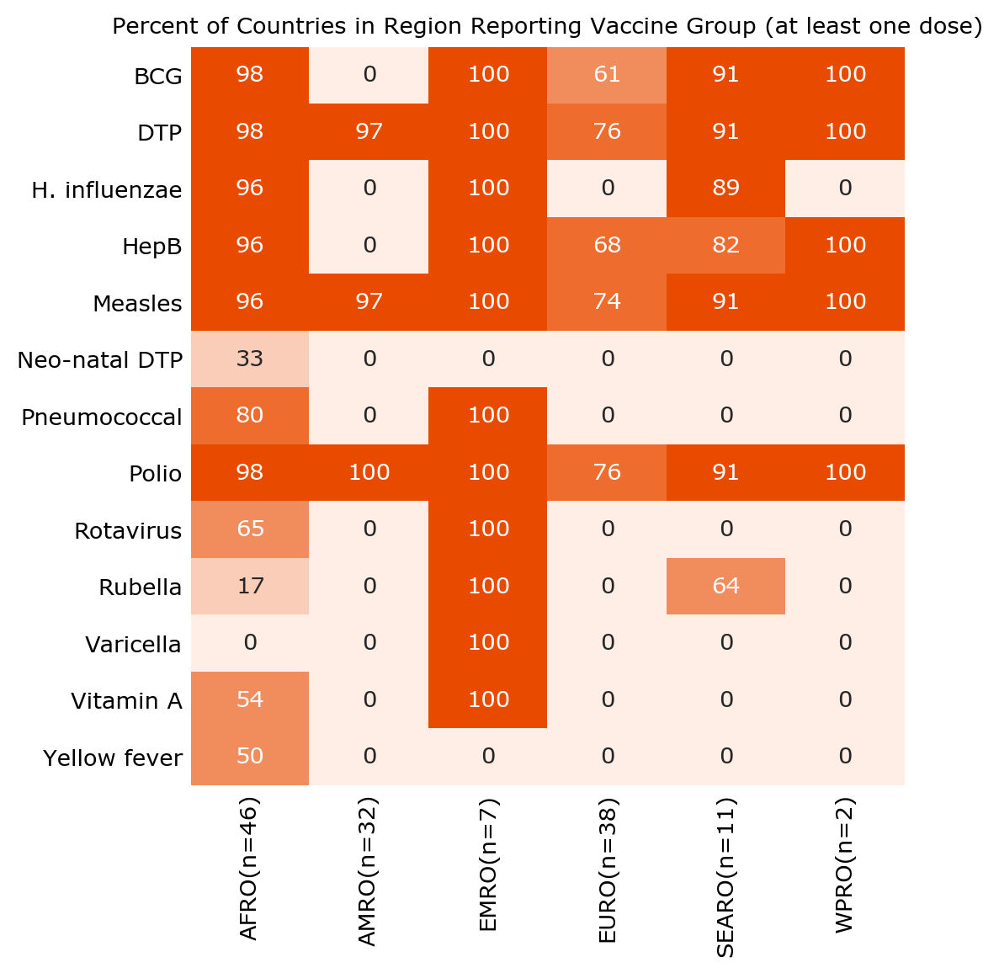

In [99]:
# to_plot = df.groupby(['group', 'WHO Region']).recalc_numerator.sum().unstack().fillna(0)

to_plot = (df.groupby(['group', 'WHO Region', 'Country Name'])
   .apply(lambda x: x.reported.any().astype(float))
   .unstack()
   .apply(pcttt, axis=1)
   .unstack()
   .fillna(0))

to_plot.rename(columns=remap, inplace=True)


with styled_fig_ax(size='square', font_size=FS, zero_lines=False, seaborn=True):
    sns.heatmap(to_plot*100,
                annot=True,
                fmt=',.0f',
                cmap=sns.light_palette(PALETTE['orange']),
                cbar=False)
    
    ax = plt.gca()
    ax.set_ylabel('')
    ax.set_xlabel('')
    
    ax.set_title('Percent of Countries in Region Reporting Vaccine Group (at least one dose)')

# Numerators

In [39]:
N_REGIONS = df.available_admin.nunique()

reports_numerators = (df.groupby('Country Name')
                        .apply(
                            lambda x: pd.notnull(x.Numerator).sum() / x.shape[0]
                        ))


print((reports_numerators > 0).sum())
reports_numerators[((0 < reports_numerators) & (reports_numerators < 1))]

37


Country Name
Brazil    0.999102
Chile     0.996146
dtype: float64

In [40]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

to_plot = df.groupby('Iso Code').Numerator.agg(lambda x: pd.notnull(x).sum() / x.shape[0])

data = [ dict(
        type = 'choropleth',
        locations = to_plot.index,
        z = to_plot,
        marker = dict(
            line = dict (
                color = 'rgb(180,180,180)',
                width = 0.0
            ) ),
      ) ]

layout = dict(
    title = 'Countries that Report Numerators',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection = dict(
            type = 'Mercator'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot( fig, validate=False, filename='d3-world-map' )

In [41]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

# percent regions with recalc numerators for at least one vaccine
to_plot = (df.groupby(['Iso Code', 'available_admin', 'Vaccine Type'])
   .recalc_numerator
   .agg(lambda x: pd.notnull(x).sum() > 0)
   .unstack(-1)
   .any(axis=1)
   .reset_index()
   .groupby('Iso Code')
   .mean()
   [0])


data = [ dict(
        type = 'choropleth',
        locations = to_plot.index,
        z = to_plot,
        marker = dict(
            line = dict (
                color = 'rgb(180,180,180)',
                width = 0.0
            ) ),
      ) ]

layout = dict(
    title = 'Countries that With Reported or Calculated Numerators',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection = dict(
            type = 'Mercator'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot( fig, validate=False, filename='d3-world-map' )

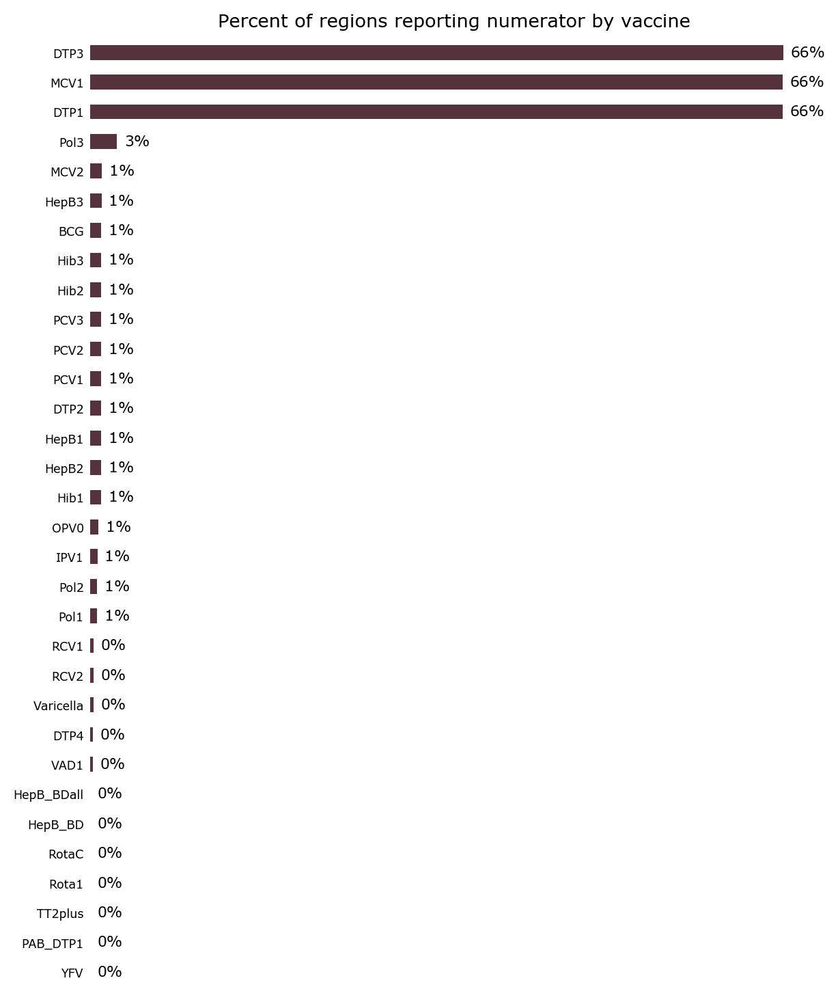

In [42]:
# top_10_vaccines = (df.groupby(['Vaccine Type']).recalc_numerator.sum().sort_values().tail(10))

reports_numerators_vax_type = (df.groupby('Vaccine Type')
                                 .Numerator
                                 .agg(lambda x: pd.notnull(x).sum() / N_REGIONS)
                                 .sort_values()
                                 .tail(100))


with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                reports_numerators_vax_type,
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['purple'])
    
    
    ax.set_ylabel('')
    ax.set_title('Percent of regions reporting numerator by vaccine')

In [43]:
pd.notnull(df.Numerator).sum() / df.shape[0]

0.2792326499484097

# Denominators

In [44]:
reports_denominators = df.groupby('Country Name').Denominator.agg(lambda x: pd.notnull(x).sum() / x.shape[0])

print((reports_denominators > 0).sum())
reports_denominators.sort_values(ascending=False)

125


Country Name
Kenya                             1.000000
Dominica                          1.000000
Ecuador                           1.000000
Equatorial Guinea                 1.000000
Estonia                           1.000000
Ethiopia                          1.000000
Gambia                            1.000000
Germany                           1.000000
Ghana                             1.000000
Grenada                           1.000000
Guatemala                         1.000000
Guyana                            1.000000
Haiti                             1.000000
Honduras                          1.000000
India                             1.000000
Indonesia                         1.000000
Jamaica                           1.000000
Kazakhstan                        1.000000
Kyrgyzstan                        1.000000
Lithuania                         1.000000
Macedonia, TFYR                   1.000000
Maldives                          1.000000
Mexico                            1.00000

In [45]:
print(pd.notnull(df.Denominator).sum())
print(pd.notnull(df.Denominator).sum() / df.shape[0])

172440
0.9669821901215737


In [46]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

to_plot = df.groupby('Iso Code').Denominator.agg(lambda x: pd.notnull(x).sum() / x.shape[0])

data = [ dict(
        type = 'choropleth',
        locations = to_plot.index,
        z = to_plot,
        marker = dict(
            line = dict (
                color = 'rgb(180,180,180)',
                width = 0.0
            ) ),
      ) ]

layout = dict(
    title = 'Countries that Report Denominators',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection = dict(
            type = 'Mercator'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot( fig, validate=False, filename='d3-world-map' )

In [47]:
df

,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage,recalc_numerator,available_admin,normalized_country,indicator,group,vaccine,timing
0,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aab Band,1.0,1266.0,NaN,51.801245,655.803767,Aab Band,afghanistan,1,BCG,BCG,1st_birth
1,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aab Kamari,1.0,4599.0,NaN,94.674670,4354.088093,Aab Kamari,afghanistan,1,BCG,BCG,1st_birth
2,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aaqcha,1.0,5674.0,NaN,72.116489,4091.889607,Aaqcha,afghanistan,1,BCG,BCG,1st_birth
3,AFG,Afghanistan,EMRO,2016,BCG,NaN,Acheen,1.0,4846.0,NaN,35.203626,1705.967701,Acheen,afghanistan,1,BCG,BCG,1st_birth
4,AFG,Afghanistan,EMRO,2016,BCG,NaN,Adraskan,1.0,3557.0,NaN,81.468327,2897.828383,Adraskan,afghanistan,1,BCG,BCG,1st_birth
5,AFG,Afghanistan,EMRO,2016,BCG,NaN,Ahmadaba,1.0,3678.0,NaN,36.243750,1333.045139,Ahmadaba,afghanistan,1,BCG,BCG,1st_birth
6,AFG,Afghanistan,EMRO,2016,BCG,NaN,Ajrestaan,1.0,3157.0,NaN,72.906053,2301.644098,Ajrestaan,afghanistan,1,BCG,BCG,1st_birth
7,AFG,Afghanistan,EMRO,2016,BCG,NaN,Alasay,1.0,1776.0,NaN,91.228211,1620.213022,Alasay,afghanistan,1,BCG,BCG,1st_birth
8,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aleengar,1.0,4571.0,NaN,65.582456,2997.774082,Aleengar,afghanistan,1,BCG,BCG,1st_birth
9,AFG,Afghanistan,EMRO,2016,BCG,NaN,Aliabad,1.0,2541.0,NaN,93.226775,2368.892365,Aliabad,afghanistan,1,BCG,BCG,1st_birth


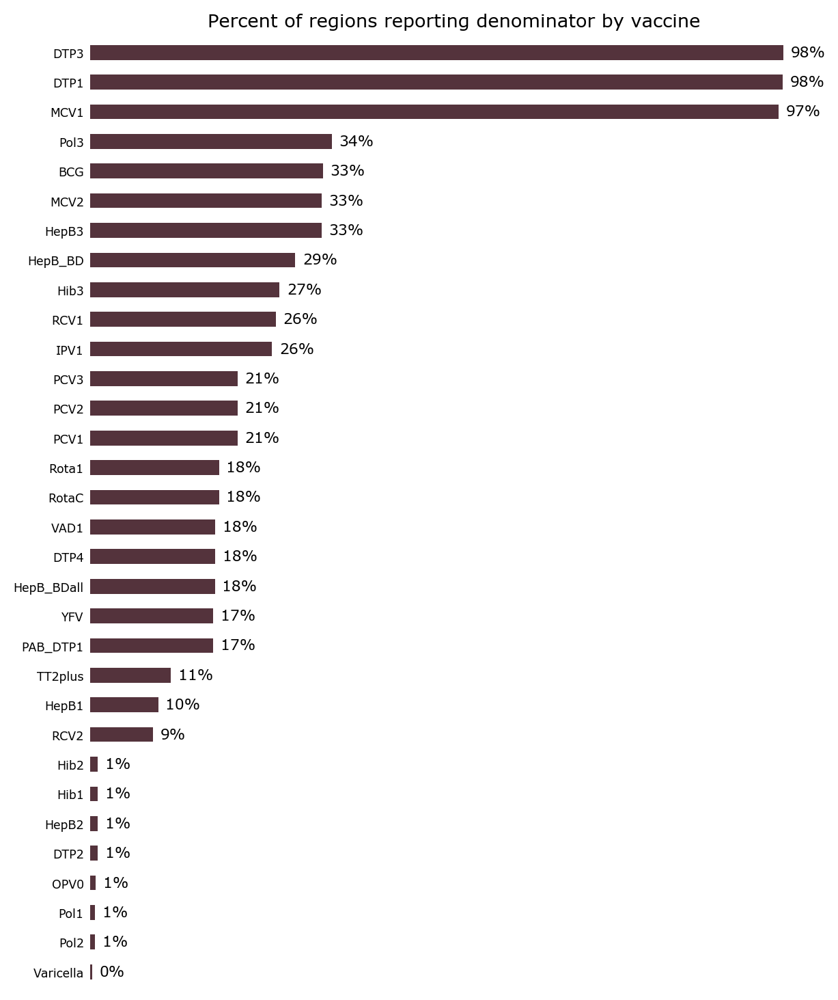

In [48]:

reports_denom_vax_type = (df.groupby('Vaccine Type')
                                 .Denominator
                                 .agg(lambda x: pd.notnull(x).sum() / N_REGIONS)
                                 .sort_values())


with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                reports_denom_vax_type,
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['purple'])
    
    
    ax.set_ylabel('')
    ax.set_title('Percent of regions reporting denominator by vaccine')
    


In [49]:
np.setdiff1d(reports_numerators[reports_numerators > 0].index.values,
             reports_denominators[reports_denominators > 0].index.values)

array([], dtype=object)

# Coverage

In [50]:
reports_coverage = df.groupby('Country Name')['Coverage'].apply(lambda x: pd.notnull(x).sum() / x.shape[0])


print((reports_coverage > 0).sum())
reports_coverage[((0 < reports_coverage) & (reports_coverage < 1))].sort_values()

136


Country Name
Latvia                  0.250000
Cabo Verde              0.363636
South Sudan             0.409091
Seychelles              0.454545
Chad                    0.454545
Guinea                  0.454545
Gabon                   0.454545
France                  0.477941
Comoros                 0.500000
Romania                 0.500000
UK                      0.500000
Equatorial Guinea       0.500000
Benin                   0.545455
Côte d'Ivoire           0.590909
Algeria                 0.590909
Ethiopia                0.590909
Slovakia                0.609375
Spain                   0.618421
DRCongo                 0.623991
Netherlands             0.625000
Denmark                 0.625000
Norway                  0.625000
Czechia                 0.625000
South Africa            0.636364
Uganda                  0.636364
Tanzania                0.636364
CAR                     0.636364
Lesotho                 0.636364
El Salvador             0.666667
Eritrea                 0.6818

In [51]:
print(pd.notnull(df.Coverage).sum())
print(pd.notnull(df.Coverage).sum() / df.shape[0])

140993
0.7906385985375264


In [52]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

to_plot = df.groupby('Iso Code').Coverage.agg(lambda x: pd.notnull(x).sum() / x.shape[0])

data = [ dict(
        type = 'choropleth',
        locations = to_plot.index,
        z = to_plot,
        marker = dict(
            line = dict (
                color = 'rgb(180,180,180)',
                width = 0.0
            ) ),
      ) ]

layout = dict(
    title = 'Countries that Report Coverage',
    geo = dict(
        showframe = False,
        showcoastlines = True,
        projection = dict(
            type = 'Mercator'
        )
    )
)

fig = dict( data=data, layout=layout )
iplot( fig, validate=False, filename='d3-world-map' )

In [53]:
# cannot be back-calced
df[pd.notnull(df.Coverage) & pd.isnull(df.Numerator) & (pd.isnull(df.Denominator) | (df.Denominator == 0))]


,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage,recalc_numerator,available_admin,normalized_country,indicator,group,vaccine,timing
10737,AZE,Azerbaijan,EURO,2016,DTP1,Hojavend,NaN,1.0,0.0,NaN,98.300000,0.0,Hojavend,azerbaijan,1,DTP,DTP1,2nd_6wks_2mos
10738,AZE,Azerbaijan,EURO,2016,DTP3,Hojavend,NaN,1.0,0.0,NaN,97.500000,0.0,Hojavend,azerbaijan,1,DTP,DTP3,4th_14wks_6mos
10739,AZE,Azerbaijan,EURO,2016,BCG,Hojavend,NaN,1.0,0.0,NaN,0.000000,0.0,Hojavend,azerbaijan,1,BCG,BCG,1st_birth
10740,AZE,Azerbaijan,EURO,2016,MCV1,Hojavend,NaN,1.0,0.0,NaN,99.300000,0.0,Hojavend,azerbaijan,1,Measles,MCV1,5th_9mos
10741,AZE,Azerbaijan,EURO,2016,MCV2,Hojavend,NaN,1.0,0.0,NaN,97.500000,0.0,Hojavend,azerbaijan,1,Measles,MCV2,NaN
10742,AZE,Azerbaijan,EURO,2016,HepB_BD,Hojavend,NaN,1.0,0.0,NaN,0.000000,0.0,Hojavend,azerbaijan,1,HepB,HepB_BD,1st_birth
10743,AZE,Azerbaijan,EURO,2016,HepB3,Hojavend,NaN,1.0,0.0,NaN,97.500000,0.0,Hojavend,azerbaijan,1,HepB,HepB3,4th_14wks_6mos
10744,AZE,Azerbaijan,EURO,2016,Pol3,Hojavend,NaN,1.0,0.0,NaN,97.500000,0.0,Hojavend,azerbaijan,1,Polio,Pol3,4th_14wks_6mos
10777,AZE,Azerbaijan,EURO,2016,DTP1,Kelbadjar,NaN,1.0,0.0,NaN,97.500000,0.0,Kelbadjar,azerbaijan,1,DTP,DTP1,2nd_6wks_2mos
10778,AZE,Azerbaijan,EURO,2016,DTP3,Kelbadjar,NaN,1.0,0.0,NaN,97.500000,0.0,Kelbadjar,azerbaijan,1,DTP,DTP3,4th_14wks_6mos


In [120]:
N_REGIONS

22885

In [125]:
(df.pivot_table(index=['Vaccine Type'],
               columns=['available_admin'],
               values='Coverage')
    .apply(lambda x: pd.notnull(x).sum() / N_REGIONS, axis=1))

Vaccine Type
BCG           0.329648
DTP1          0.968145
DTP2          0.010444
DTP3          0.996548
DTP4          0.012759
HepB1         0.061744
HepB2         0.010444
HepB3         0.327463
HepB_BD       0.095608
HepB_BDall    0.019532
Hib1          0.010444
Hib2          0.010444
Hib3          0.269784
IPV1          0.172952
MCV1          0.995630
MCV2          0.217479
OPV0          0.007603
PAB_DTP1      0.067861
PCV1          0.192222
PCV2          0.186410
PCV3          0.192397
Pol1          0.006598
Pol2          0.006598
Pol3          0.350317
RCV1          0.047236
RCV2          0.014813
Rota1         0.128163
RotaC         0.130435
TT2plus       0.145860
VAD1          0.085558
Varicella     0.002840
YFV           0.083810
dtype: float64

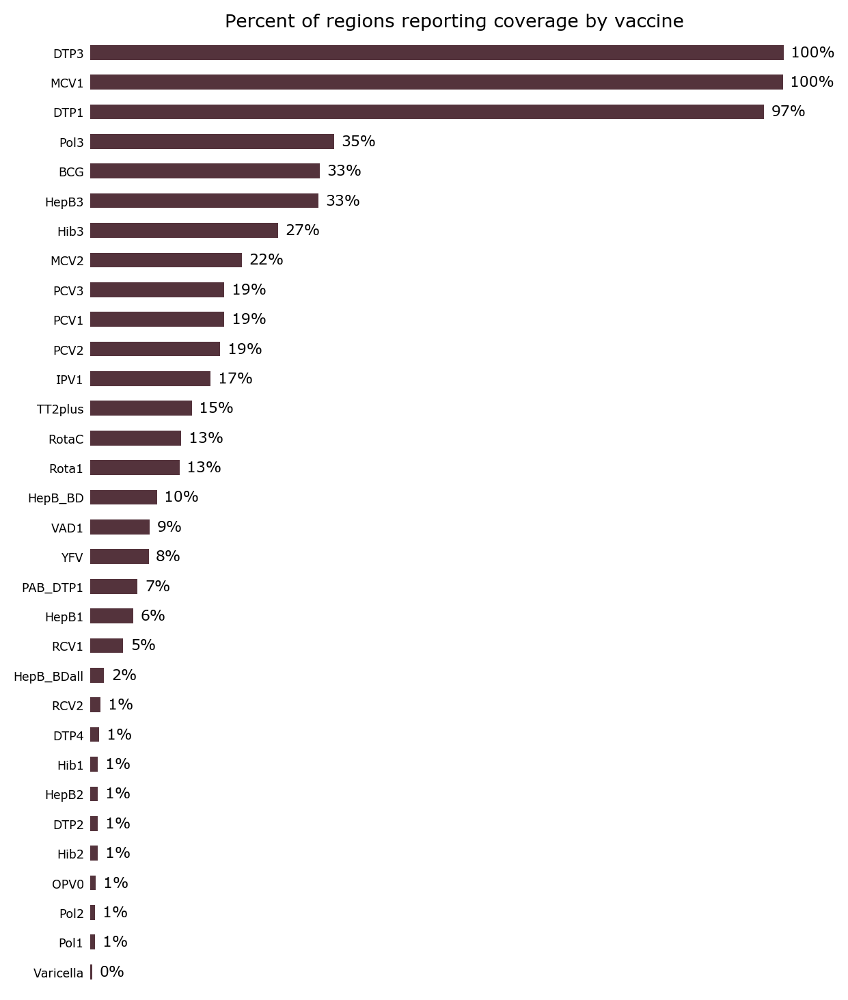

In [128]:
# reports_cov_vax_type = (df.groupby(['Vaccine Type', 'available_admin'])
#                                  .Coverage
#                                  .first()
#                                  .agg(lambda x: pd.notnull(x).sum() / N_REGIONS)
#                                  .sort_values())

reports_cov_vax_type = (df.pivot_table(index=['Vaccine Type'],
               columns=['available_admin'],
               values='Coverage')
    .apply(lambda x: pd.notnull(x).sum() / N_REGIONS, axis=1)
    .sort_values())


with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                reports_cov_vax_type,
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['purple'])
    
    
    ax.set_ylabel('')
    ax.set_title('Percent of regions reporting coverage by vaccine')
    


## Small handful of transcription/mathematical errors

If num and denom, does that equal the coverage?

In [55]:
has_both = df[pd.notnull(df.Numerator) & pd.notnull(df.Denominator)]

has_both['calc_cov'] = np.round(100 * has_both.Numerator / has_both.Denominator)


errors = has_both[~np.isclose(has_both.calc_cov, has_both.Coverage, atol=1e1) &
                  pd.notnull(has_both.calc_cov) &
                  ~np.isinf(has_both.calc_cov)]

(errors[['Country Name', 'Admin2', 'Numerator', 'Denominator', 'Coverage', 'calc_cov']]
     .rename(columns=dict(Coverage='Reported Coverage',
                          calc_cov='Calculated Coverage')))

/Users/bull/anaconda3/envs/subnational-vaccines/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,Country Name,Admin2,Numerator,Denominator,Reported Coverage,Calculated Coverage
4956,Brunei,BRUNEI MUARA DISTRICT,1591.0,4594.0,100.000000,35.0
81219,Guyana,Upper Demerara-Berbice,879.0,969.0,105.000000,91.0
81238,Guyana,Potaro-Siparuni,894.0,349.0,101.000000,256.0
81350,Honduras,Humuya,32.0,12.0,256.985494,267.0
117162,Suriname,Corneliskondre,1.0,1.0,0.000000,100.0
137106,Trinidad & Tobago,Belle Garden,39.0,33.0,11.820000,118.0
137119,Trinidad & Tobago,Castara,4.0,7.0,36.360000,57.0


# Missing Data

In [56]:
# zeros are really missing data
replaced_denoms = df.Denominator.replace({0: np.nan})

missing_just_numerator = (pd.notnull(replaced_denoms) & pd.notnull(df.Coverage) & pd.isnull(df.Numerator))
missing_just_denominator = (pd.notnull(df.Coverage) & pd.notnull(df.Numerator) & pd.isnull(replaced_denoms))
missing_just_coverage = (pd.notnull(replaced_denoms) & pd.notnull(df.Numerator) & pd.isnull(df.Coverage))

numerator_recalc = np.where(missing_just_numerator,
                            replaced_denoms * (df.Coverage / 100.),
                            df.Numerator)

denom_recalc = np.where(missing_just_denominator,
                            df.Numerator / (df.Coverage / 100.),
                            np.nan)


coverage_recalc = np.where(missing_just_coverage,
                            df.Numerator / replaced_denoms,
                            np.nan)

In [57]:
missing_just_coverage.sum()

0

In [58]:
missing_just_denominator.sum()

166

In [59]:
missing_just_numerator.sum()

86767

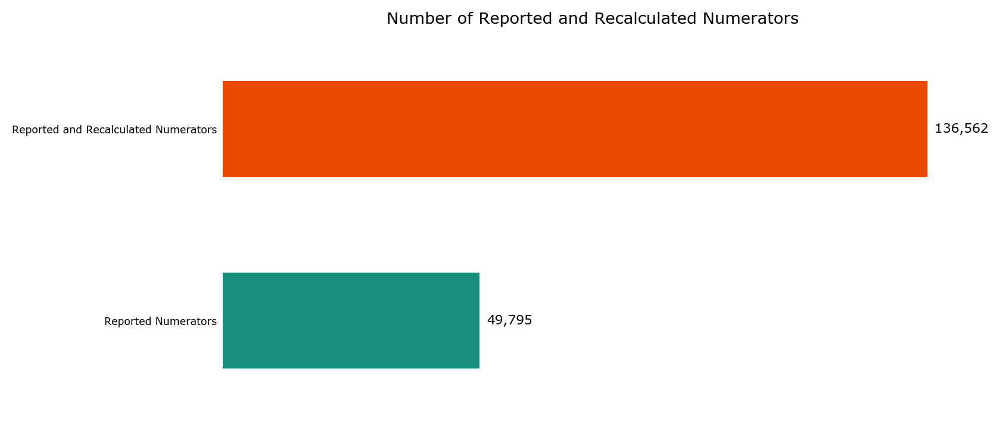

In [60]:
to_plot = pd.Series({
    'Reported Numerators': pd.notnull(df.Numerator).sum(),
    'Reported and Recalculated Numerators': pd.notnull(numerator_recalc).sum()
}, name='Recalculated Numerators')


with styled_fig_ax(size='quarter', font_size=FS, x_formatter=comma_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                to_plot,
                font_size=FS,
                horizontal=True,
                label_formatter=comma_func_formatter(),
#                 color=PALETTE['lime']
               )
    
    
    ax.set_ylabel('')
    ax.set_title('Number of Reported and Recalculated Numerators')
    


# Suspect Data

In [61]:
n_regions_gb = df.groupby('Country Name').available_admin.nunique().sort_index()
n_regions_gb.head()

Country Name
Afghanistan    350
Albania         36
Algeria         48
Angola         166
Argentina      513
Name: available_admin, dtype: int64

In [62]:
to_plot = (df[df.recalc_numerator > replaced_denoms]
           .groupby('Country Name')
           .available_admin
           .nunique()
           .sort_values())

to_plot.sort_index().head()

Country Name
Afghanistan    167
Albania          0
Algeria          0
Angola          98
Argentina      292
Name: available_admin, dtype: int64

In [63]:
df[df['Country Name'] == 'Botswana']

,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage,recalc_numerator,available_admin,normalized_country,indicator,group,vaccine,timing
33215,BWA,Botswana,AFRO,2016,HepB_BD,BOBIRWA,BOBIRWA,1.0,1640.0,NaN,NaN,NaN,BOBIRWA - BOBIRWA,botswana,1,HepB,HepB_BD,1st_birth
33216,BWA,Botswana,AFRO,2016,BCG,BOBIRWA,BOBIRWA,1.0,1640.0,NaN,78.846006,1293.074491,BOBIRWA - BOBIRWA,botswana,1,BCG,BCG,1st_birth
33217,BWA,Botswana,AFRO,2016,DTP1,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,129.806839,2031.477034,BOBIRWA - BOBIRWA,botswana,1,DTP,DTP1,2nd_6wks_2mos
33218,BWA,Botswana,AFRO,2016,DTP3,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,104.049992,1628.382379,BOBIRWA - BOBIRWA,botswana,1,DTP,DTP3,4th_14wks_6mos
33219,BWA,Botswana,AFRO,2016,DTP4,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,NaN,NaN,BOBIRWA - BOBIRWA,botswana,1,DTP,DTP4,NaN
33220,BWA,Botswana,AFRO,2016,HepB_BDall,BOBIRWA,BOBIRWA,1.0,1640.0,NaN,73.845717,1211.069767,BOBIRWA - BOBIRWA,botswana,1,NaN,NaN,NaN
33221,BWA,Botswana,AFRO,2016,HepB3,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,104.049992,1628.382379,BOBIRWA - BOBIRWA,botswana,1,HepB,HepB3,4th_14wks_6mos
33222,BWA,Botswana,AFRO,2016,Hib3,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,104.049992,1628.382379,BOBIRWA - BOBIRWA,botswana,1,H. influenzae,Hib3,4th_14wks_6mos
33223,BWA,Botswana,AFRO,2016,IPV1,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,60.908871,953.223837,BOBIRWA - BOBIRWA,botswana,1,Polio,IPV1,4th_14wks_6mos
33224,BWA,Botswana,AFRO,2016,MCV1,BOBIRWA,BOBIRWA,2.0,1565.0,NaN,107.884759,1688.396472,BOBIRWA - BOBIRWA,botswana,1,Measles,MCV1,5th_9mos


In [64]:
(df.recalc_numerator > replaced_denoms).sum()

40350

In [65]:
(df.recalc_numerator > replaced_denoms).sum() / df.shape[0]

0.22626844914988112

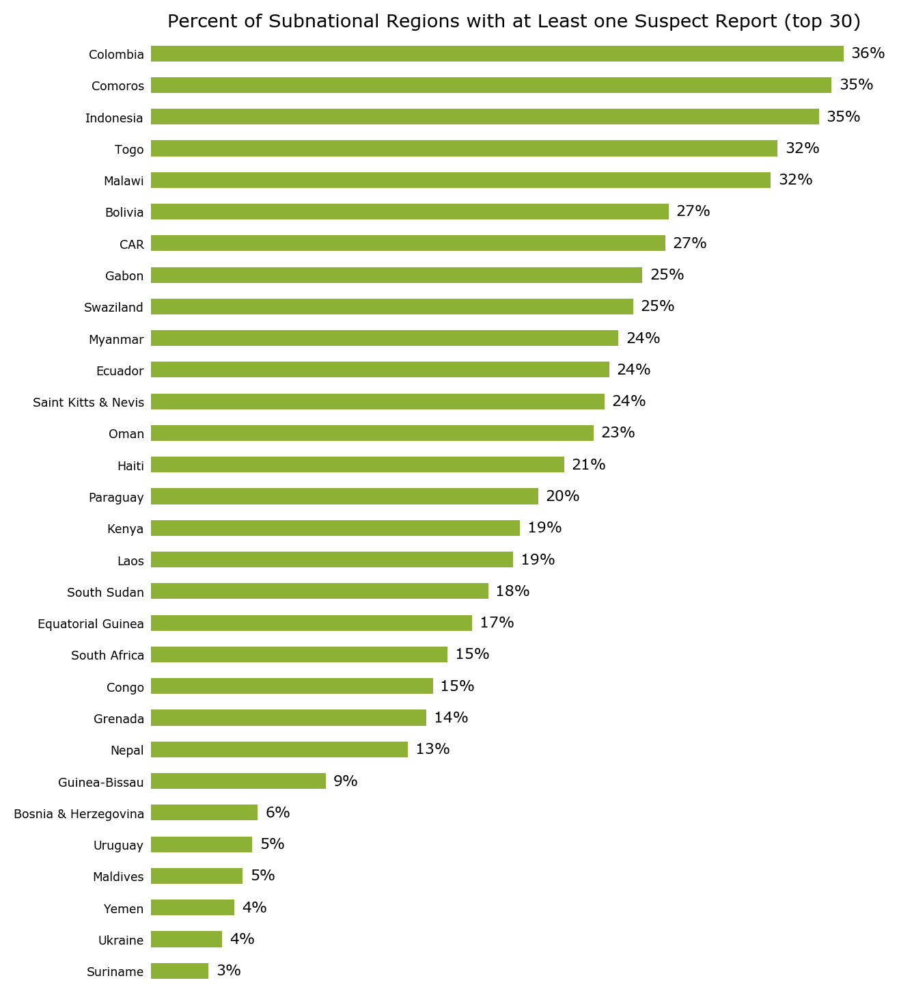

In [66]:
to_plot = (df[df.recalc_numerator > replaced_denoms]
           .groupby('Country Name')
           .available_admin
           .nunique()
           .sort_values())

to_plot = to_plot.sort_index().divide(n_regions_gb)

to_plot = to_plot[to_plot > 0].sort_values()

PLOT_LIM = 30

with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                to_plot.head(PLOT_LIM),
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['lime']
               )
    
    
    ax.set_ylabel('')
    ax.set_title('Percent of Subnational Regions with at Least one Suspect Report (top {})'.format(PLOT_LIM))
    



In [67]:
# denom = (dropout.groupby(['Country Name', 'available_admin'])
#                 .Denominator
#                 .mean()
#                 .replace({0: np.nan})
#                 .dropna())

# denom

In [100]:
# with_n_regions.head()

In [101]:
regions = (df.groupby(['Country Name', 'Vaccine Type'])
             .available_admin
             .nunique()
             .unstack(-1)
             .max(axis=1))

regions.name = 'n_regions'

with_n_regions = df.merge(regions.to_frame(), left_on='Country Name', right_index=True)

((with_n_regions.groupby(['Country Name', 'Vaccine Type'])
               .apply(lambda x: x.available_admin.count() / x.n_regions.max())) >= 1)#.all()




#    .reset_index()
#    .groupby('Country Name')
#    .agg(lambda x: x / x.max())
#    . 
#    .pipe(lambda x: x / x.max())
#    .unstack())

ValueError: Buffer dtype mismatch, expected 'Python object' but got 'double'

Exception ignored in: 'pandas._libs.lib.is_bool_array'
ValueError: Buffer dtype mismatch, expected 'Python object' but got 'double'


Country Name  Vaccine Type
Afghanistan   BCG             True
              DTP1            True
              DTP3            True
              HepB3           True
              Hib3            True
              MCV1            True
              MCV2            True
              PCV1            True
              PCV2            True
              PCV3            True
              Pol3            True
Albania       BCG             True
              DTP1            True
              DTP3            True
              HepB3           True
              HepB_BD         True
              MCV1            True
              MCV2            True
              Pol3            True
Algeria       BCG             True
              DTP1            True
              DTP3            True
              DTP4            True
              HepB3           True
              HepB_BD         True
              HepB_BDall      True
              Hib3            True
              IPV1          

In [102]:
with_n_regions[with_n_regions['Iso Code'] == 'AFG'].available_admin.nunique()

350

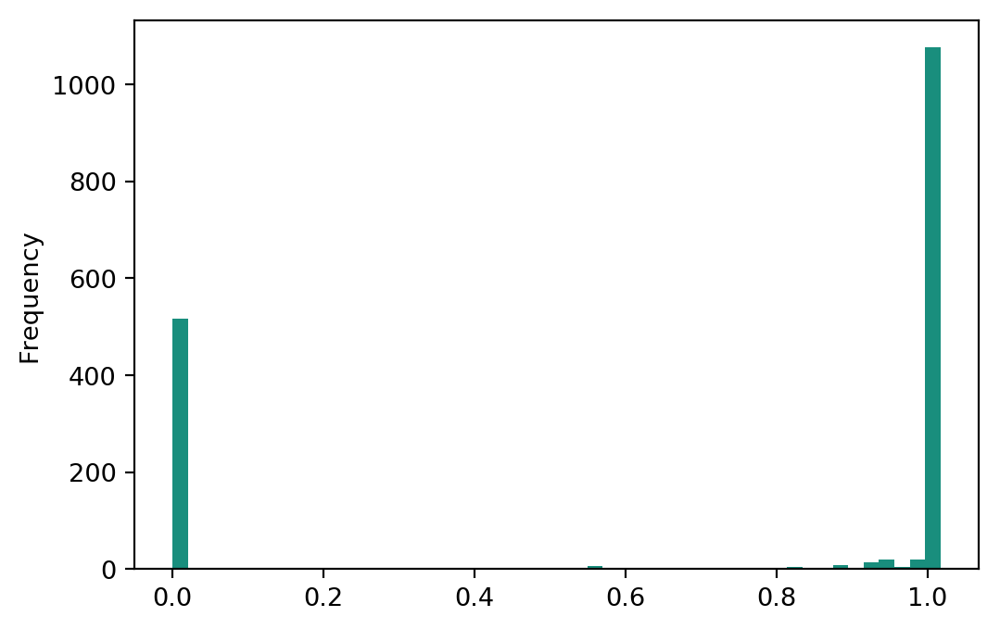

In [103]:
((with_n_regions.groupby(['Country Name', 'Vaccine Type'])
               .apply(lambda x: pd.notnull(x.recalc_numerator).sum() / x.n_regions.max()))).plot.hist(bins=50)#.all()



In [104]:
dropout = df[df['Vaccine Type'].isin(['DTP1', 'DTP3'])]

dtp_counts = (dropout.groupby(['Country Name', 'available_admin', 'Vaccine Type'])
        .recalc_numerator
        .first()
        .unstack(-1)
        .dropna())

dropout_count = (dtp_counts
        .diff(axis=1)
        .DTP3)


# dropout_count.divide(denom[dropout_count.index]).plot.hist(bins=500, xlim=[-10, 10])


mean_dropout = (dropout_count.divide(dtp_counts.DTP1)
                             .replace({np.inf: np.nan})
                             .dropna().abs().groupby('Country Name').mean().sort_values(ascending=False))


# .sort_values().plot.hist(bins=500, xlim=[-10, 10])



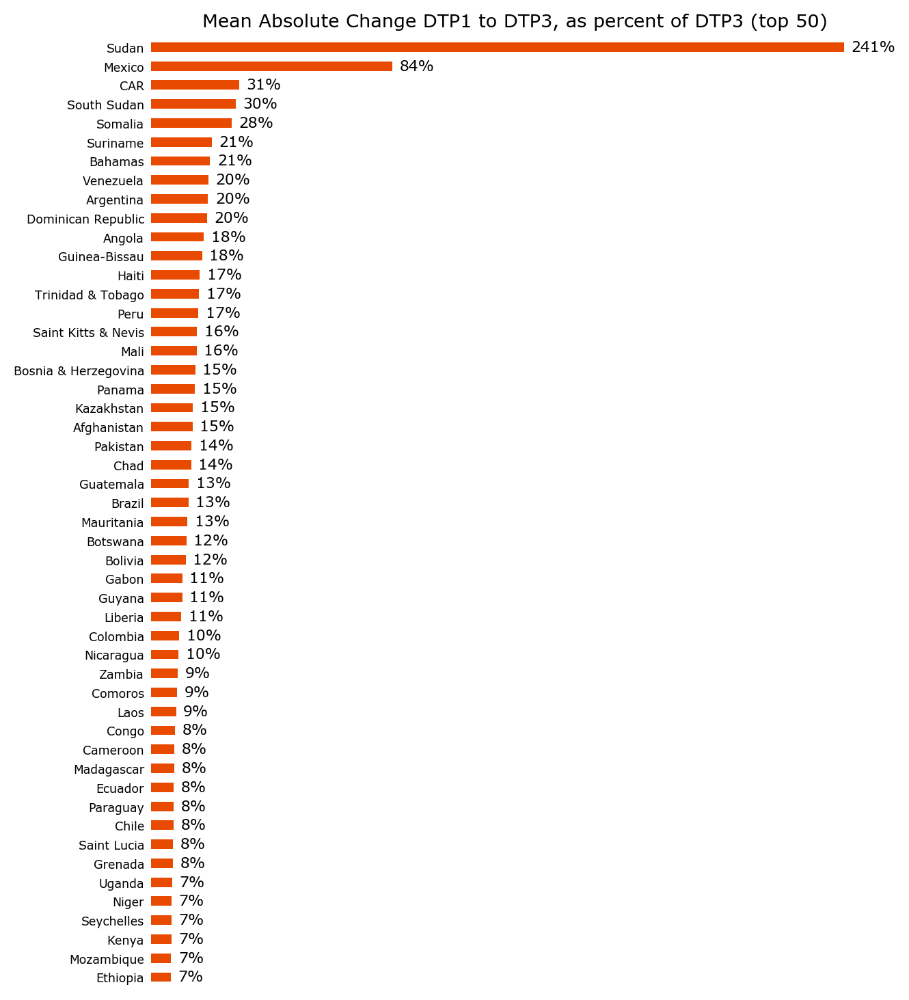

In [105]:
to_plot = mean_dropout

PLOT_LIM = 50

with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
    labeled_bar(ax,
                to_plot.head(PLOT_LIM).sort_values(),
                font_size=FS,
                horizontal=True,
                label_formatter=pct_func_formatter(),
                color=PALETTE['orange']
               )
    
    
    ax.set_ylabel('')
    ax.set_title('Mean Absolute Change DTP1 to DTP3, as percent of DTP3 (top {})'.format(PLOT_LIM))
    



In [106]:
# to_plot = ((replaced_denoms - df.recalc_numerator)
#            .divide(replaced_denoms)
#            .groupby('Country Name')
#            .available_admin
#            .nunique()
#            .sort_values())

# to_plot = to_plot.sort_index().divide(n_regions_gb)

# to_plot = to_plot[to_plot > 0].sort_values()

# PLOT_LIM = 30

# with styled_fig_ax(size='tall', font_size=FS, x_formatter=pct_func_formatter(), zero_lines=False) as ax:
#     labeled_bar(ax,
#                 to_plot.head(PLOT_LIM),
#                 font_size=FS,
#                 horizontal=True,
#                 label_formatter=pct_func_formatter(),
#                 color=PALETTE['lime']
#                )
    
    
#     ax.set_ylabel('')
#     ax.set_title('Percent of Subnational Regions with at Least one Suspect Report (top {})'.format(PLOT_LIM))
    



# Contemporaneous vaccines

In [107]:
coef_var = (df.groupby(['Country Name', 'available_admin', 'timing'])
              .Numerator
              .agg(lambda x: np.mean(np.abs(x - x.mean()) / x.mean()))
              .dropna()
              .reset_index()
              .groupby('Country Name')
              .Numerator
              .mean()
              .dropna()
              .sort_values())

coef_var

Country Name
Argentina                         0.000000
Uruguay                           0.000000
Trinidad & Tobago                 0.000000
Suriname                          0.000000
Saint Vincent & The Grenadines    0.000000
Saint Lucia                       0.000000
Saint Kitts & Nevis               0.000000
Peru                              0.000000
Paraguay                          0.000000
Panama                            0.000000
Nicaragua                         0.000000
Mexico                            0.000000
Laos                              0.000000
Jamaica                           0.000000
Honduras                          0.000000
Guyana                            0.000000
Haiti                             0.000000
Grenada                           0.000000
Bahamas                           0.000000
Barbados                          0.000000
Belize                            0.000000
Bolivia                           0.000000
Brazil                            0.00000

In [108]:
coef_var = (df.groupby(['Country Name', 'available_admin', 'timing'])
              .recalc_numerator
              .agg(lambda x: np.mean(np.abs(x - x.mean()) / x.mean()))
              .dropna()
              .reset_index())
#               .groupby('Country Name')
#               .recalc_numerator
#               .mean()
#               .dropna()
#               .sort_values())

coef_var

,Country Name,available_admin,timing,recalc_numerator
0,Afghanistan,Aab Band,1st_birth,0.000000e+00
1,Afghanistan,Aab Band,2nd_6wks_2mos,9.849521e-02
2,Afghanistan,Aab Band,3rd_10wks_4mos,0.000000e+00
3,Afghanistan,Aab Band,4th_14wks_6mos,0.000000e+00
4,Afghanistan,Aab Band,5th_9mos,0.000000e+00
5,Afghanistan,Aab Kamari,1st_birth,0.000000e+00
6,Afghanistan,Aab Kamari,2nd_6wks_2mos,2.755817e-02
7,Afghanistan,Aab Kamari,3rd_10wks_4mos,0.000000e+00
8,Afghanistan,Aab Kamari,4th_14wks_6mos,3.433661e-04
9,Afghanistan,Aab Kamari,5th_9mos,0.000000e+00


In [109]:
df.to_csv(Path('../data/interim/calc_cols_added.csv'))

In [110]:
coef_var = (df.groupby(['Country Name', 'available_admin', 'timing'])
              .Denominator
              .agg(lambda x: np.mean(np.abs(x - x.mean()) / x.mean()))
              .dropna()
              .reset_index()
              .groupby('Country Name')
              .Denominator
              .mean()
              .dropna()
              .sort_values())

coef_var

Country Name
Spain                             0.000000
Jamaica                           0.000000
Indonesia                         0.000000
India                             0.000000
Honduras                          0.000000
Haiti                             0.000000
Guyana                            0.000000
Slovakia                          0.000000
Kazakhstan                        0.000000
Guatemala                         0.000000
Somalia                           0.000000
Germany                           0.000000
Georgia                           0.000000
South Africa                      0.000000
Republic of Moldova               0.000000
Sri Lanka                         0.000000
Estonia                           0.000000
Grenada                           0.000000
Kyrgyzstan                        0.000000
Laos                              0.000000
Lithuania                         0.000000
Portugal                          0.000000
Poland                            0.00000

In [111]:
df[df['Country Name'] == 'Angola']

,Iso Code,Country Name,WHO Region,Year,Vaccine Type,Admin1,Admin2,DenomType,Denominator,Numerator,Coverage,recalc_numerator,available_admin,normalized_country,indicator,group,vaccine,timing,reported
6483,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Bocoio,2.0,6024.0,NaN,87.0,5240.88,BENGUELA - Bocoio,angola,1,HepB,HepB3,4th_14wks_6mos,True
6510,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Caimbambo,2.0,6431.0,NaN,56.0,3601.36,BENGUELA - Caimbambo,angola,1,HepB,HepB3,4th_14wks_6mos,True
6511,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Catumbela,2.0,3193.0,NaN,85.0,2714.05,BENGUELA - Catumbela,angola,1,HepB,HepB3,4th_14wks_6mos,True
6512,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Chongoroi,2.0,11180.0,NaN,104.0,11627.20,BENGUELA - Chongoroi,angola,1,HepB,HepB3,4th_14wks_6mos,True
6513,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Cubal,2.0,8614.0,NaN,75.0,6460.50,BENGUELA - Cubal,angola,1,HepB,HepB3,4th_14wks_6mos,True
6514,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Ganda,2.0,3323.0,NaN,74.0,2459.02,BENGUELA - Ganda,angola,1,HepB,HepB3,4th_14wks_6mos,True
6515,AGO,Angola,AFRO,2016,HepB3,BENGUELA,Lobito,2.0,14378.0,NaN,81.0,11646.18,BENGUELA - Lobito,angola,1,HepB,HepB3,4th_14wks_6mos,True
6516,AGO,Angola,AFRO,2016,Hib3,BENGUELA,Baia Farta,2.0,3945.0,NaN,111.0,4378.95,BENGUELA - Baia Farta,angola,1,H. influenzae,Hib3,4th_14wks_6mos,True
6517,AGO,Angola,AFRO,2016,Hib3,BENGUELA,Balombo,2.0,3986.0,NaN,79.0,3148.94,BENGUELA - Balombo,angola,1,H. influenzae,Hib3,4th_14wks_6mos,True
6518,AGO,Angola,AFRO,2016,Hib3,BENGUELA,Benguela,2.0,20549.0,NaN,71.0,14589.79,BENGUELA - Benguela,angola,1,H. influenzae,Hib3,4th_14wks_6mos,True


In [112]:
coef_var.sort_values(ascending=False)

Country Name
Angola                            0.043740
Burundi                           0.020356
Cameroon                          0.014583
CAR                               0.012221
DRCongo                           0.011836
Equatorial Guinea                 0.011240
Uganda                            0.010476
Burkina Faso                      0.009763
South Sudan                       0.009388
Guinea                            0.009195
Chad                              0.008965
Gambia                            0.008902
Mali                              0.008817
Sierra Leone                      0.008437
Côte d'Ivoire                     0.007992
Comoros                           0.007482
Niger                             0.007399
Togo                              0.007097
Mozambique                        0.006853
Afghanistan                       0.006676
Ethiopia                          0.006615
Liberia                           0.006347
Benin                             0.00618

# Benford

Initialized sequence with 49637 registries.

Test performed on 49637 registries.
Discarded 0 records < 1 after preparation.

The entries with the significant positive deviations are:

             Expected     Found   Z_score
First_1_Dig                              
4             0.09691  0.105163  6.208109

The Mean Absolute Deviation is 0.0028416808623147067
For the First Digit:
            - 0.0000 to 0.006: Close Conformity
            - 0.006 to 0.012: Acceptable Conformity
            - 0.012 to 0.015: Marginally Acceptable Conformity
            - Above 0.015: Nonconformity

Mean Square Error = 2.0273586408824362e-05

The Chi-square statistic is 61.95157739104641
Critical Chi-square for this series: 31.827


/Users/bull/anaconda3/envs/subnational-vaccines/lib/python3.6/site-packages/benford/benford.py:332: UserWarning:

Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access



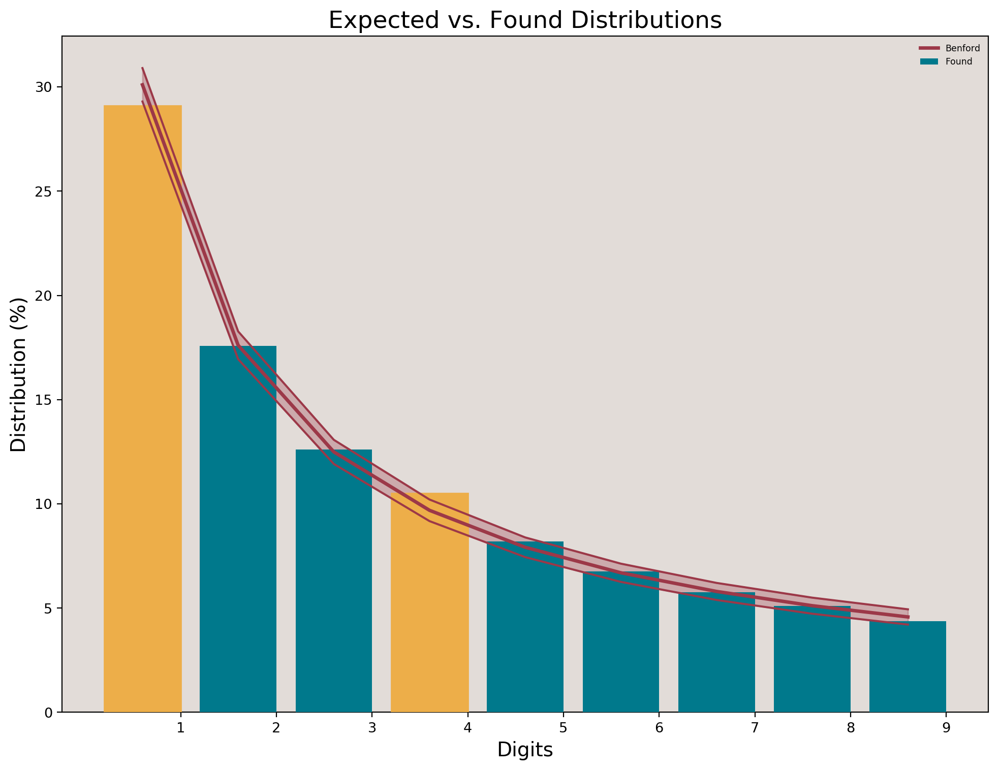

In [113]:
import benford as bf


f1d = bf.first_digits(df.Numerator, digs=1, decimals=8, confidence="99.99", MAD=True, MSE=True, chi_square=True)

Initialized sequence with 172313 registries.

Test performed on 172313 registries.
Discarded 0 records < 1 after preparation.

The entries with the significant positive deviations are:

             Expected     Found    Z_score
First_1_Dig                               
4            0.096910  0.113642  23.473740
5            0.079181  0.092721  20.810006
3            0.124939  0.133699  10.993670
6            0.066947  0.070343   5.635785

The Mean Absolute Deviation is 0.009707708085460509
For the First Digit:
            - 0.0000 to 0.006: Close Conformity
            - 0.006 to 0.012: Acceptable Conformity
            - 0.012 to 0.015: Marginally Acceptable Conformity
            - Above 0.015: Nonconformity

Mean Square Error = 0.00018225283544191163

The Chi-square statistic is 1713.6514916209928
Critical Chi-square for this series: 31.827


/Users/bull/anaconda3/envs/subnational-vaccines/lib/python3.6/site-packages/benford/benford.py:332: UserWarning:

Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access



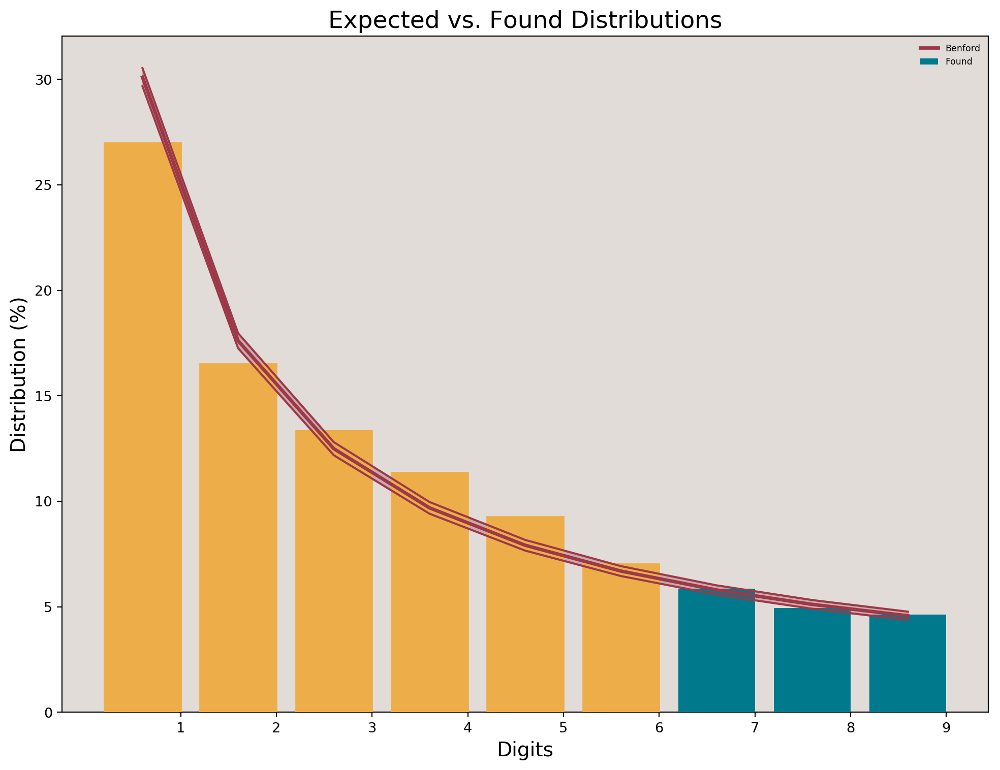

In [114]:
import benford as bf


f1d = bf.first_digits(df.Denominator, digs=1, decimals=8, confidence="99.99", MAD=True, MSE=True, chi_square=True)

Initialized sequence with 135444 registries.

Test performed on 135444 registries.
Discarded 0 records < 1 after preparation.

The entries with the significant positive deviations are:

             Expected     Found    Z_score
First_1_Dig                               
4            0.096910  0.109580  15.757649
5            0.079181  0.087232  10.967274
3            0.124939  0.130017   5.648033

The Mean Absolute Deviation is 0.00625014362999689
For the First Digit:
            - 0.0000 to 0.006: Close Conformity
            - 0.006 to 0.012: Acceptable Conformity
            - 0.012 to 0.015: Marginally Acceptable Conformity
            - Above 0.015: Nonconformity

Mean Square Error = 9.313771115410719e-05

The Chi-square statistic is 638.774139766287
Critical Chi-square for this series: 31.827


/Users/bull/anaconda3/envs/subnational-vaccines/lib/python3.6/site-packages/benford/benford.py:332: UserWarning:

Pandas doesn't allow columns to be created via a new attribute name - see https://pandas.pydata.org/pandas-docs/stable/indexing.html#attribute-access



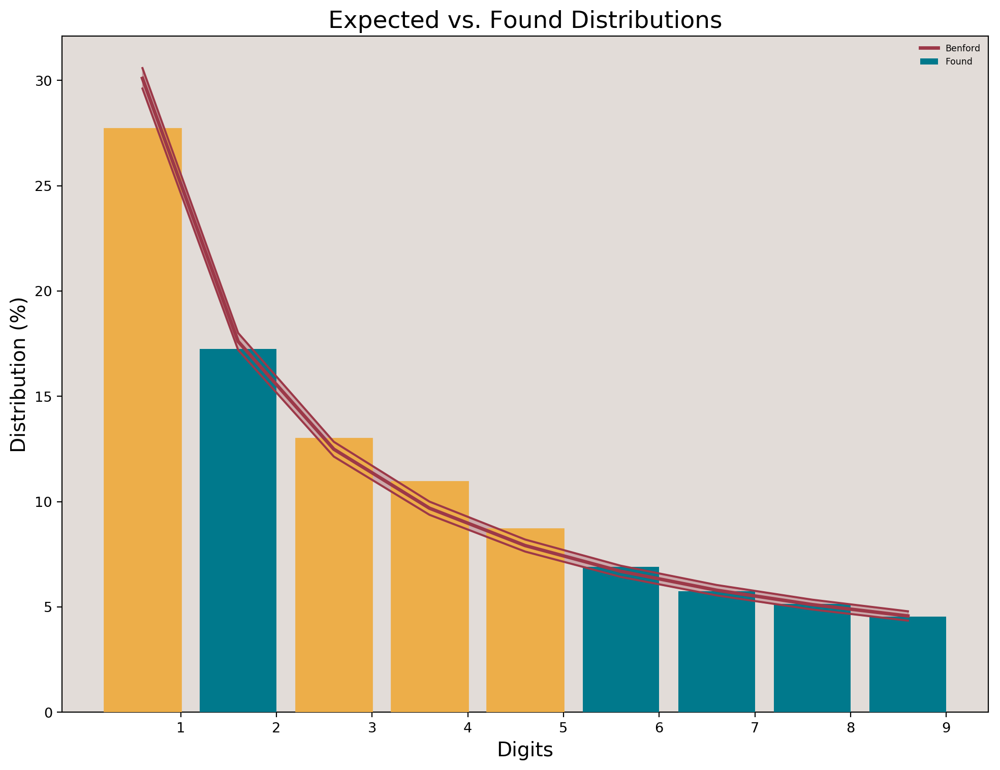

In [115]:
import benford as bf


f1d = bf.first_digits(df.recalc_numerator, digs=1, decimals=8, confidence="99.99", MAD=True, MSE=True, chi_square=True)

In [116]:
def _benford(x, min_n=100):
    test_series = x.Denominator[pd.notnull(x.Denominator)].unique()
    if len(test_series) >= min_n:
        return bf.mad(test_series, 1, decimals=2, sign='all')
    else:
        return 0

a = df.groupby("Iso Code").apply(_benford)

a[a > 0.01].sort_values()

Iso Code
COL    0.011872
HND    0.012002
AGO    0.012341
GTM    0.012573
ECU    0.013924
IDN    0.014064
VEN    0.014331
DOM    0.014510
PRY    0.015458
OMN    0.015648
CMR    0.015668
BOL    0.015873
SDN    0.018727
CHL    0.018795
NIC    0.019110
SUR    0.019305
AFG    0.019381
IND    0.019448
SEN    0.020224
SOM    0.023203
ZMB    0.023319
PAN    0.023981
MOZ    0.024584
CRI    0.027066
GAB    0.027720
PAK    0.027831
ETH    0.028764
CIV    0.029417
TTO    0.029634
MRT    0.032036
UGA    0.032171
CUB    0.032325
ZWE    0.035043
TCD    0.035372
PRK    0.036415
HTI    0.036973
LAO    0.039549
SSD    0.040726
MMR    0.043041
MLI    0.047728
MDG    0.049132
ERI    0.049529
COD    0.052858
TZA    0.055464
GHA    0.059614
BFA    0.061327
BEN    0.070616
dtype: float64

Initialized sequence with 353 registries.

Test performed on 353 registries.
Discarded 0 records < 1 after preparation.

The entries with the significant positive deviations are:

             Expected     Found   Z_score
First_1_Dig                              
1            0.301030  0.450425  6.061105
9            0.045757  0.093484  4.163958
8            0.051153  0.093484  3.489339

The Mean Absolute Deviation is 0.05546429952838258
For the First Digit:
            - 0.0000 to 0.006: Close Conformity
            - 0.006 to 0.012: Acceptable Conformity
            - 0.012 to 0.015: Marginally Acceptable Conformity
            - Above 0.015: Nonconformity


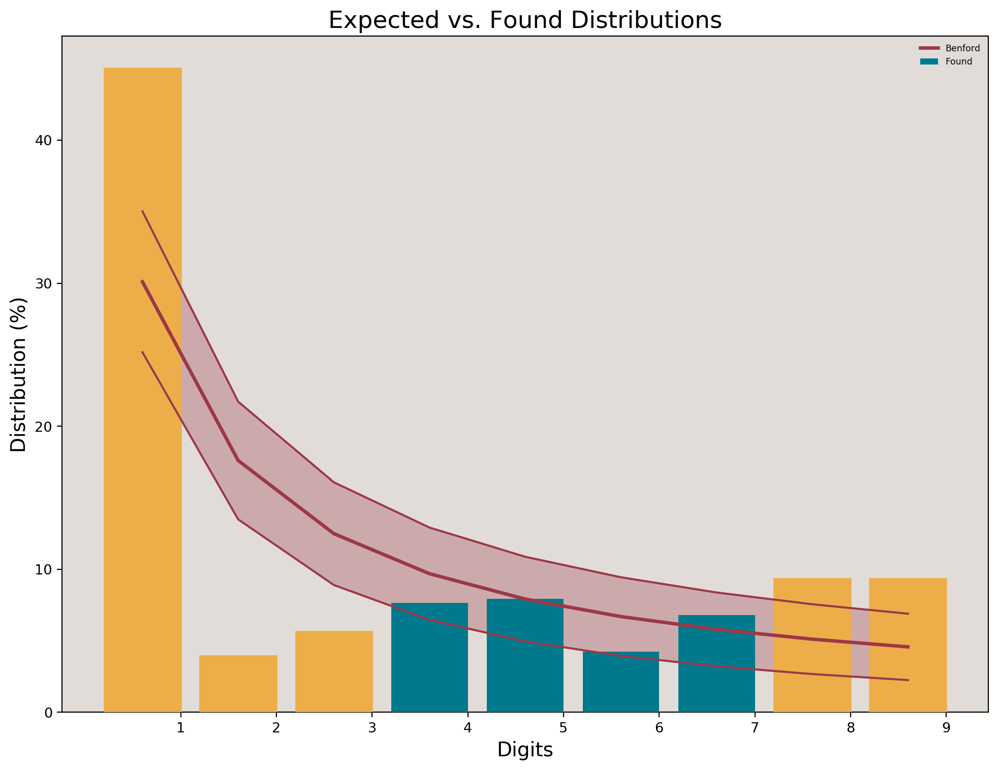

array([18994., 14382., 10242.,  5480., 11932.,  7779.,  9112., 18068.,
       13663.,  9730.,  5206., 11335.,  7602., 54205., 78827., 60790.,
       50036., 72764., 56114.,  9690., 15241., 10246., 17863., 12129.,
       13856., 13260.,  9205., 14479.,  9733., 16970., 11523., 13163.,
       12597., 12441., 20230., 34070.,  8542., 10745.,  8218., 10699.,
       17398., 29300.,  9182.,  9240.,  7067., 10616.,  6325.,  9115.,
        2190., 11088., 10085.,  6008.,  8660.,  2026., 10588., 14677.,
       13144.,  5844., 15064., 14565.,  9194., 24514., 14521., 13943.,
       12487.,  5551., 14311., 13837.,  8734., 23289., 13795.,  7374.,
        9550.,  5486.,  7690.,  6747.,  8737.,  5019.,  7035., 11186.,
        7369., 18727.,  9159., 11493.,  9305.,  9476., 16873., 10627.,
        7001., 17790.,  8701., 10919.,  8840.,  9002., 16029.,  7914.,
       15038.,  9896.,  4941.,  9809.,  9272.,  4372.,  7235., 12532.,
        8907.,  4517.,  8969.,  8693.,  4247.,  7908.,  8049.,  3269.,
      

In [117]:
def benford_country(code):
    series = df[df['Iso Code'] == code].Denominator.unique()
    bf.first_digits(series,
                    digs=1,
                    decimals=8,
                    confidence="95",
                    MAD=True)
    
    return series
    
benford_country('TZA')

In [118]:
f1d = bf.mad(df.Numerator, test=, decimals=8)

SyntaxError: invalid syntax (<ipython-input-118-19b78937abf3>, line 1)